In [1]:
import os
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

os.chdir('../')
current_path = os.getcwd()

from blastfurnace.config import get_cfg
from blastfurnace.data.datasets import ArcelorMittalDataset

cfg = get_cfg()
cfg.merge_from_file("configs/run_med_temp/LINEAR_REG_TEMP.yaml")
full_dataset = ArcelorMittalDataset(cfg["DATASET"])
x, y, full_y, feature_names = full_dataset.build_dataset()

splits = full_dataset.all_to_splits(x, y, full_y)
train_x, train_y, train_full_y = splits["train"]
val_x, val_y, val_full_y = splits["val"]
test_x, test_y, test_full_y = splits["test"]
predictions = pd.read_csv(os.path.join("experiments","run_med_temp","scikit_linear_reg_h16","inference_20220920-152219","predictions.csv"))

- Extrapolating features: 100%|███████████| 5983/5983 [00:03<00:00, 1942.22it/s]


In [2]:
def split_by_run_id(df):
    df = df.sort_values(by=['run_id', 'original_date']).copy(deep=True)
    split_by_runid = df[df['run_id'].shift(1) != df['run_id']]['original_date'] - pd.to_timedelta('1s')
    return df.merge(split_by_runid, on='original_date', how='outer').sort_values(by=['original_date'])

In [3]:
fig = px.line(split_by_run_id(full_y[['original_date', 'temperature', 'run_id', 'delta_temp_last_temp']]),
              x="original_date", y="temperature", hover_data=['run_id', 'delta_temp_last_temp'])

# vertical lines for Hot and Cold
fig.add_hline(y=1500+20, line_dash="dot", annotation_text="Hot", annotation_position="top right", annotation_font_color="red")
fig.add_hline(y=1500-20, line_dash="dot", annotation_text="Cold", annotation_position="bottom right", annotation_font_color="blue")

# paradas
# for i, (start_date, end_date) in full_dataset.df_paradas.iterrows():
#     fig.add_vrect(x0=start_date, x1=end_date, row="all", col=1, fillcolor="orange", opacity=0.15, line_width=0)

# add possible outliers (delta temp > 60)
# possible_outliers = full_y['delta_temp_last_temp'].abs() > 60
# fig.add_trace(
#     go.Scatter(
#         x=full_y['original_date'],
#         y=full_y['temperature'],
#         mode="markers",
#         showlegend=False)
# )
# fig.update_layout(title={'text': "Temperature over Time", 'x':0.5, 'xanchor': 'center'})
# fig.show()

In [4]:
fig = px.histogram(full_y, x='delta_temp_last_temp')
fig.update_layout(title={'text': r"$\text{Histogram of }\Delta\text{temperature}_{t} - \Delta\text{temperature}_{t-1}$", 'x':0.5, 'xanchor': 'center'})
fig.show()

In [5]:
import plotly.graph_objects as go
fig = go.Figure(data=[go.Histogram(x=full_y['delta_temp_last_temp'].abs(), cumulative_enabled=True, cumulative={'direction': 'decreasing'})])
# fig['layout']['xaxis']['autorange'] = "reversed"
fig.update_layout(title={'text': r"$\text{Cumulative Histogram of }|\Delta\text{temperature}_{t} - \Delta\text{temperature}_{t-1}|$", 'x':0.5, 'xanchor': 'center'})
fig.show()


KeyboardInterrupt



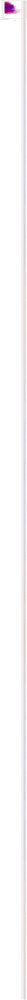

In [8]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots()

for key, grp in predictions.groupby(["run_id"]):
    ax = grp.plot(ax=ax, kind='line', x='date', y='y_pred', c='blue', label=key)
    ax = grp.plot(ax=ax, kind='line', x='date', y='y_true', c='red', label=key)
    
plt.show()